In [20]:
import astropy
import numpy as np
import matplotlib

from astropy.io import fits
from scipy.ndimage import gaussian_filter
import matplotlib.pyplot as plt

In [22]:
plt.rcParams['figure.figsize'] = (9, 6)

In [12]:
# gets index of a specific velocity

def v_indx(v_val): # v_val must be in m/s
    v_indx = int((v_val - (3.04208717990 * 10 ** 4)) / (-2.44297870185 * 10 ** 2))
    return v_indx

In [2]:
# doing initial Fourier transform

def fft(im):
    im[np.where((im < 3) | (im > 30))] = 0 # 3 and 30 = velocity limits
    im = np.fft.fftshift(np.fft.fft2(im))
    return im

In [3]:
# masking low frequency data

def mask(im, radius):
    rows, cols = im.shape
    center_row, center_col = int(rows / 2), int(cols / 2)
    mask = np.ones((rows, cols), np.uint8)
    radius = radius
    center = [center_row, center_col]
    x, y = np.ogrid[:rows, :cols]
    mask_area = (x - center[0]) ** 2 + (y - center[1]) ** 2 <= radius * radius
    mask[mask_area] = 0
    im = im * mask 
    
    return im

In [4]:
# going from Fourier space to regular image space

def ifft(im_masked):
    inv_im = np.fft.ifft2(np.fft.ifftshift(im_masked))
    return inv_im

In [6]:
# masking border noise

def mask_border(im):
    rows, cols = im.shape
    maskb = np.ones((rows, cols))
    # upper border, lower border, left border, right border (in that order)
    maskb[:, 0:200], maskb[:, cols - 200:cols], maskb[0:200, :], maskb[rows - 200:rows, :] = 0., 0., 0., 0. 

    maskb = gaussian_filter(maskb, sigma = 500)
    
    # only applying mask to borders of image
    im[:, 0:200] = im[:, 0:200] * maskb[:, 0:200]
    im[:, cols - 200:cols] = im[:, cols - 200:cols] * maskb[:, cols - 200:cols]
    im[0:200, :] = im[0:200, :] * maskb[0:200, :]
    im[rows - 200:rows, :] = im[rows - 200:rows, :] * maskb[rows - 200:rows, :]
    
    
    return im

In [34]:
# produces row of FFT images

def fft_row(v, vmin, vmax, radii, maskb = False):
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/LMC_30Dor_fg/the actual cube!.fits') # reset
    fig, ax = plt.subplots(1, 4, figsize = (50, 25), constrained_layout=True, facecolor = 'w')
    j = 0

    for i in radii:
        im = file[0].data[v_indx(v), :, :]
        
        if maskb:
            im_nonoise = mask_border(im)
            im_fft = fft(im_nonoise)
        else:
            im_fft = fft(im)
            
        im_masked = mask(im_fft, i)
        im_final = ifft(im_masked)
    
        ax[j].imshow(np.flip(np.abs(im_final), axis = 0), cmap = 'magma', vmin = vmin, vmax = vmax)
        ax[j].grid(False)
        ax[j].axes.xaxis.set_visible(False)
        ax[j].axes.yaxis.set_visible(False)
        ax[j].set_title('r = ' + str(i), fontsize = 70)
    
        j += 1
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/LMC_30Dor_fg/the actual cube!.fits') # reset
    

In [15]:
# produces j 1 image w/h FFT/mask/IFFT applied to it

def fft_indiv(v, radius):
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/LMC_30Dor_fg/the actual cube!.fits') # reset
    im = file[0].data[v_indx(v), :, :]
    im_nonoise = mask_border(im)
    im_fft = fft(im_nonoise)
    im_masked = mask(im_fft, radius)
    im_final = ifft(im_masked)
    file = fits.open('/Users/FRANNYPACK/Downloads/grind!/research/Data/LMC_30Dor_fg/the actual cube!.fits') # reset
    return im_final

In [18]:
# @ 9.41 km/s

im1 = fft_indiv(9.41 * 10 ** 3, 1)

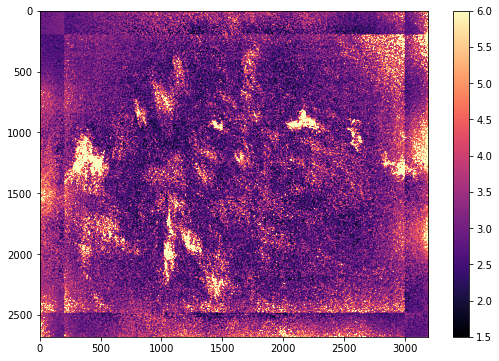

In [23]:
plt.imshow(np.flip(np.abs(im1), axis = 0), cmap = 'magma', vmin = 1.5, vmax = 6)
plt.colorbar()

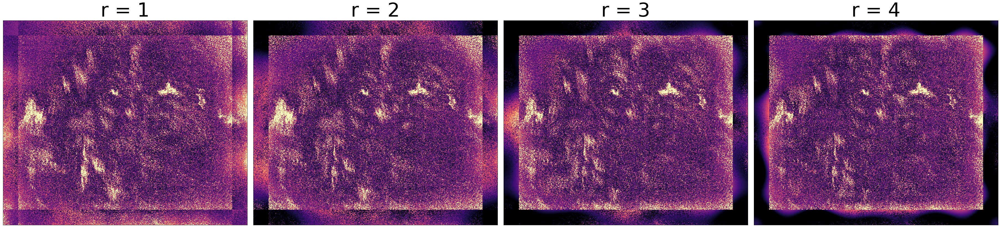

In [24]:
fft_row(9.41 * 10 ** 3, 1.5, 6, np.arange(1, 5, 1))

In [25]:
im2 = fft_indiv(4.04 * 10 ** 3, 1)

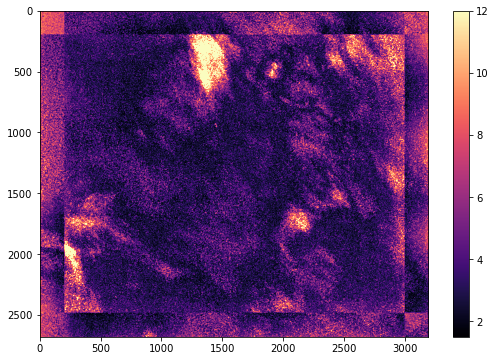

In [31]:
plt.imshow(np.flip(np.abs(im2), axis = 0), cmap = 'magma', vmin = 1.5, vmax = 12)
plt.colorbar()

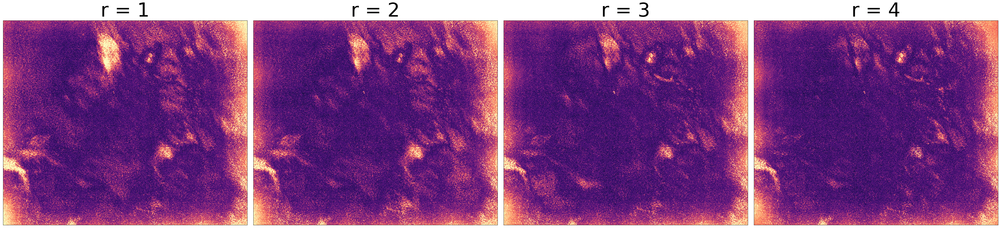

In [35]:
fft_row(4.04 * 10 ** 3, 0, 12, np.arange(1, 5, 1))

In [36]:
im3 = fft_indiv(-5.98 * 10 ** 3, 1)

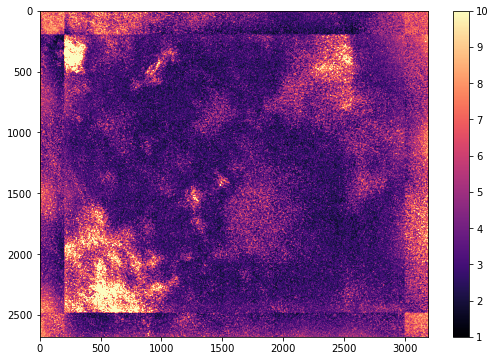

In [37]:
plt.imshow(np.flip(np.abs(im3), axis = 0), cmap = 'magma', vmin = 1, vmax = 10)
plt.colorbar()

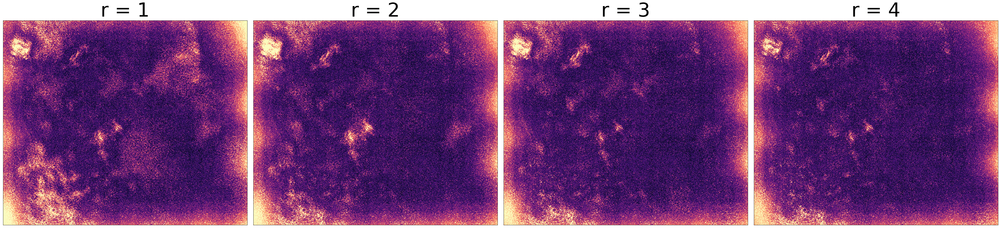

In [38]:
fft_row(-5.98 * 10 ** 3, 1, 10, np.arange(1, 5, 1))

In [39]:
im4 = fft_indiv(-1.06 * 10 ** 4, 1)

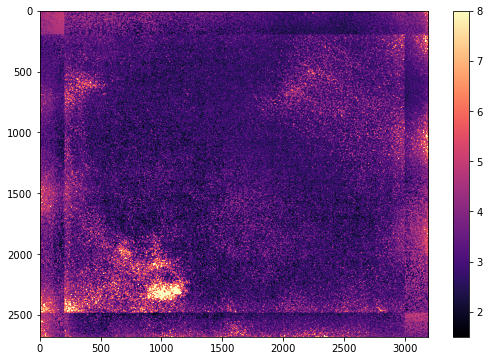

In [40]:
plt.imshow(np.flip(np.abs(im4), axis = 0), cmap = 'magma', vmin = 1.5, vmax = 8)
plt.colorbar()

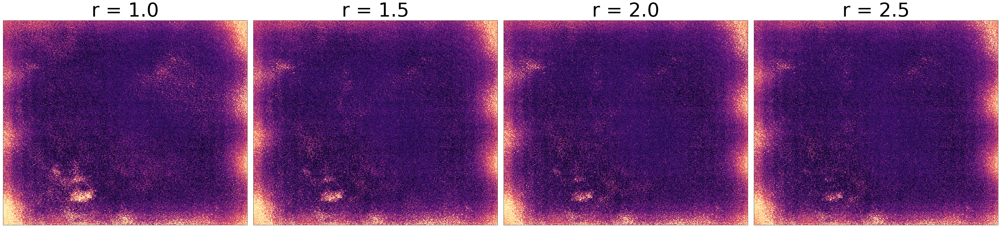

In [41]:
fft_row(-1.06 * 10 ** 4, 1.5, 8, np.arange(1, 3, 0.5))